In [269]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error
import seaborn as sns
import category_encoders as ce
from sklearn.preprocessing import OneHotEncoder
#import plotly as py
import plotly.express as px
from plotly.subplots import make_subplots

In [270]:
sd =  pd.read_csv('./Data/store.csv', index_col = 0)
td =  pd.read_csv('./Data/train.csv', low_memory=False)

In [271]:
#dropping Customers col
#del td['Customers']

In [272]:
#merge(left_df, right_df, on=’Customer_id’, how=’inner’)
data = pd.merge(sd,td, on = 'Store')

In [273]:
# Drop rows with no sales
data = data.loc[(data["Sales"] != 0)]

In [274]:
# checking to see how many null values we have in each of the other columns
columns_with_nulls = []
for column in data.columns:
    if data.loc[:, column].isnull().any():
        columns_with_nulls.append(column)

for column in columns_with_nulls:
    percent_missing = round(((data.loc[data.loc[:, column].isnull()].shape[0] / data.shape[0]) * 100), 4)
    print("Column {} has {}% missing values \n".format(column, percent_missing))

Column CompetitionDistance has 0.2639% missing values 

Column CompetitionOpenSinceMonth has 31.7725% missing values 

Column CompetitionOpenSinceYear has 31.7725% missing values 

Column Promo2SinceWeek has 49.264% missing values 

Column Promo2SinceYear has 49.264% missing values 

Column PromoInterval has 49.264% missing values 

Column DayOfWeek has 2.976% missing values 

Column Sales has 3.5759% missing values 

Column Customers has 3.0119% missing values 

Column Open has 3.0173% missing values 

Column Promo has 3.0057% missing values 

Column StateHoliday has 3.0218% missing values 

Column SchoolHoliday has 3.0342% missing values 



In [275]:
# for columns with only a very small amoung of null values, we will simply drop the nulls that are there.
columns_with_few_nulls = ['CompetitionDistance',
                          'DayOfWeek',
                          'Sales',
                          'Open',
                          'Promo',
                          'StateHoliday',
                          'SchoolHoliday',
                          'Customers',
                         ]
for column in columns_with_few_nulls:
    data = data.loc[~data.loc[:, column].isnull()]

In [276]:
data['CompetitionOpenSinceYear'].fillna(data['CompetitionOpenSinceYear'].mean(), inplace = True)
data['CompetitionOpenSinceMonth'].fillna(data['CompetitionOpenSinceMonth'].mean(), inplace = True)

In [277]:
del data['Promo2SinceWeek']
del data['Promo2SinceYear']
del data['PromoInterval']

In [278]:
data['StoreType'].value_counts()

a    222917
d    127561
c     54990
b      7431
Name: StoreType, dtype: int64

In [279]:
col_types = {"Date": "datetime64[ns]", "DayOfWeek": int, "Store": int, 
             "Open": int, "Promo": int, "SchoolHoliday": str}
data = data.astype(col_types, copy=False)

In [280]:
le = LabelEncoder()  
data['StoreType'] = le.fit_transform(data['StoreType'])
data['Assortment'] = le.fit_transform(data['Assortment'])
data['StateHoliday'] = le.fit_transform(data['StateHoliday'])
data['Sales'] = data['Sales']/1000000
#data['PromoInterval'] = le.fit_transform(data['PromoInterval'])
# Convert StateHoliday to dummy varibles
#dummies = pd.get_dummies(data['StateHoliday'], prefix='StateHoliday')[['StateHoliday_a','StateHoliday_b', 'StateHoliday_c']]
#data = pd.concat([data, dummies], axis=1)
#data.drop(labels=['StateHoliday'], inplace=True, axis=1)

In [281]:
#mean encode
def mean_encode(data, col, on):
    group = data.groupby(col).mean()
    mapper = {k: v for k, v in zip(group.index, group.loc[:, on].values)}

    data.loc[:, col] = data.loc[:, col].replace(mapper)
    data.loc[:, col].fillna(value=np.mean(data.loc[:, col]), inplace=True)

    return data

In [282]:
mean_encode(data, col='Store', on='Sales')
# Target Encoding for Store
#ce_te = ce.TargetEncoder(cols=["Store"])

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Date,DayOfWeek,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
2,0.004777,2,0,1270.0,9.000000,2008.000000,0,2013-01-03,4,0.004327,578.0,1,0,0,1.0
3,0.004777,2,0,1270.0,9.000000,2008.000000,0,2013-01-04,5,0.004486,619.0,1,0,0,1.0
6,0.004777,2,0,1270.0,9.000000,2008.000000,0,2013-01-07,1,0.007176,785.0,1,1,0,1.0
7,0.004777,2,0,1270.0,9.000000,2008.000000,0,2013-01-08,2,0.005580,654.0,1,1,0,1.0
8,0.004777,2,0,1270.0,9.000000,2008.000000,0,2013-01-09,3,0.005471,626.0,1,1,0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
618463,0.005854,3,2,5350.0,7.228116,2008.684521,1,2014-07-22,2,0.004604,383.0,1,0,0,0.0
618464,0.005854,3,2,5350.0,7.228116,2008.684521,1,2014-07-23,3,0.004831,375.0,1,0,0,0.0
618465,0.005854,3,2,5350.0,7.228116,2008.684521,1,2014-07-24,4,0.005639,404.0,1,0,0,0.0
618470,0.005854,3,2,5350.0,7.228116,2008.684521,1,2014-07-29,2,0.007220,440.0,1,1,0,1.0


In [283]:
#enc_nom_1 = (data.groupby('Store').size()) / len(data)
#data['Store_f_enc'] = data['Store'].apply(lambda x : enc_nom_1[x])

In [284]:
data.head()

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Date,DayOfWeek,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
2,0.004777,2,0,1270.0,9.0,2008.0,0,2013-01-03,4,0.004327,578.0,1,0,0,1.0
3,0.004777,2,0,1270.0,9.0,2008.0,0,2013-01-04,5,0.004486,619.0,1,0,0,1.0
6,0.004777,2,0,1270.0,9.0,2008.0,0,2013-01-07,1,0.007176,785.0,1,1,0,1.0
7,0.004777,2,0,1270.0,9.0,2008.0,0,2013-01-08,2,0.005580,654.0,1,1,0,1.0
8,0.004777,2,0,1270.0,9.0,2008.0,0,2013-01-09,3,0.005471,626.0,1,1,0,1.0


In [285]:
# Change date to datetime
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')
data['Year'] = data['Date'].dt.year
data['Month'] = data['Date'].dt.month
data['Day'] = data['Date'].dt.day
data['WeekOfYear'] = data['Date'].dt.isocalendar().week
data['DayOfYear'] = data['Date'].dt.dayofyear

In [286]:
data.head()

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Date,DayOfWeek,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,Year,Month,Day,WeekOfYear,DayOfYear
2,0.004777,2,0,1270.0,9.0,2008.0,0,2013-01-03,4,0.004327,578.0,1,0,0,1.0,2013,1,3,1,3
3,0.004777,2,0,1270.0,9.0,2008.0,0,2013-01-04,5,0.004486,619.0,1,0,0,1.0,2013,1,4,1,4
6,0.004777,2,0,1270.0,9.0,2008.0,0,2013-01-07,1,0.007176,785.0,1,1,0,1.0,2013,1,7,2,7
7,0.004777,2,0,1270.0,9.0,2008.0,0,2013-01-08,2,0.005580,654.0,1,1,0,1.0,2013,1,8,2,8
8,0.004777,2,0,1270.0,9.0,2008.0,0,2013-01-09,3,0.005471,626.0,1,1,0,1.0,2013,1,9,2,9


<AxesSubplot:>

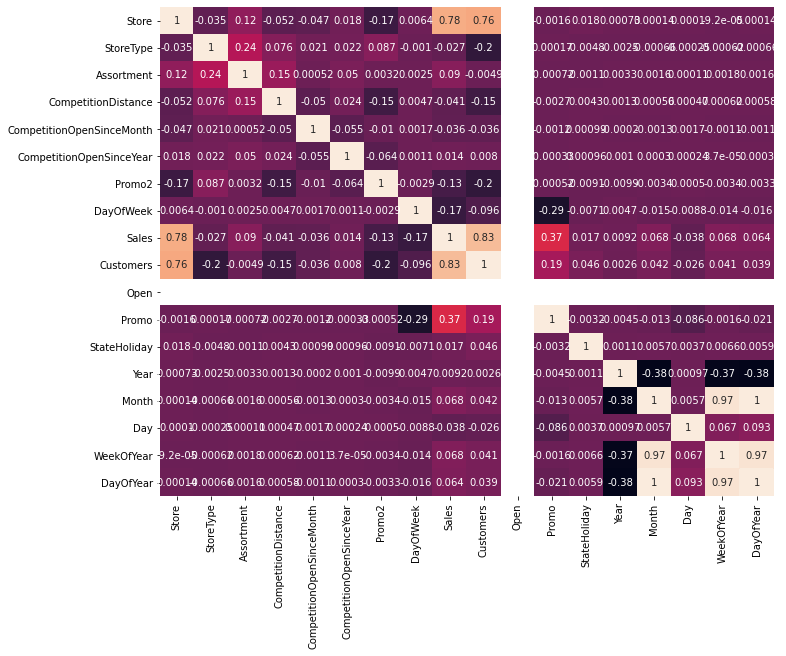

In [287]:
# Check correlations
plt.subplots(figsize=(11,9))
sns.heatmap(data.corr(), cbar=False, annot=True)

In [288]:
X = data.drop(columns="Sales")
y = data.loc[:, "Sales"]

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2, random_state=None, shuffle=False)

In [289]:
def metric(preds, actuals):
    #preds = preds.reshape(-1)
    #actuals = actuals.reshape(-1)
    assert preds.shape == actuals.shape
    # return 100 * np.linalg.norm((actuals - preds) / actuals) / np.sqrt(preds.shape[0])
    return 100 * (np.sqrt(np.mean(np.square((actuals - preds) / actuals))))

In [290]:
features = ["Customers", "Promo", "DayOfWeek"]

rfr = RandomForestRegressor(max_depth=20, n_estimators=50)
rfr.fit(X_train[features], y_train)
y_pred = rfr.predict(X_test[features])

print(f"Random Forest Regresor with features {features} yield {metric(y_test, y_pred):.2f}% as error")

Random Forest Regresor with features ['Customers', 'Promo', 'DayOfWeek'] yield 20.27% as error


In [ ]:
# Using mean as Baseline
y_pred = np.array([y_train.mean() for _ in range(y_test.shape[0])])
print(f"Baseline yield {metric(y_pred, y_test):.2f}% as error")

In [ ]:
data[]

In [ ]:
#avg_Sales_by_StoreType = data.groupby("StoreType").mean()['Sales'].sort_values(ascending=False)
avg_Sales_by_DayOfWeek = data.groupby("DayOfWeek").mean()['Sales']
Sales_by_WeekOfYear = data.groupby("WeekOfYear").mean()['Sales']


In [234]:
#fig, ax = plt.subplots(nrows=1, figsize=(12,7))

#Sales_by_WeekOfYear.plot(ax=ax, kind='bar')

#ax.set_title('Avg Sales per Week of Year')

#fig;
x_week = data['WeekOfYear'].unique()
fig=px.scatter(
    x=x_week,
    y=Sales_by_WeekOfYear,
    title='Sales over week of year',
    width= 900,
    height= 500,
)
fig.show()

In [241]:
fig.update_traces(
    mode='lines+markers',
).update_layout(xaxis_title='WeekOfYear',
                   yaxis_title='Average Sales',)

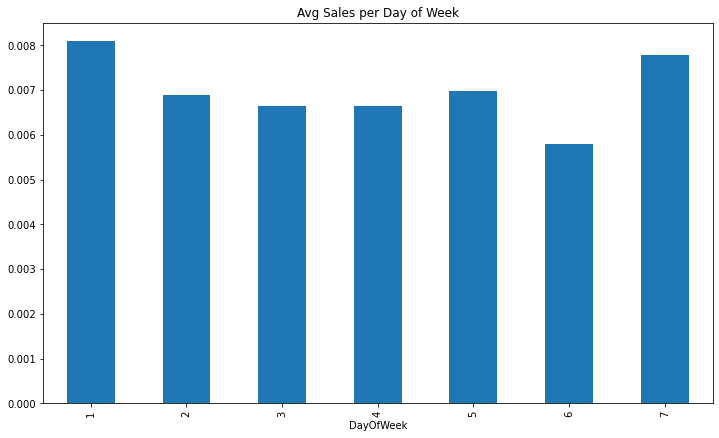

In [242]:
fig, ax = plt.subplots(nrows=1, figsize=(12,7))

avg_Sales_by_DayOfWeek.plot(ax=ax, kind='bar')

ax.set_title('Avg Sales per Day of Week')

fig;

In [243]:
fig=px.scatter(
    data,
    x='Customers',
    y='Sales',
    color='StoreType',
    title='Sales-Customers in different store types',
    color_discrete_map = 'identity',
    width= 600,
    height= 500,
)
fig.show()

In [266]:
fig = px.pie(data, values='Sales', names='StoreType', title='Sales-StoreType')
fig.show()

In [244]:
sales_promo = data.groupby("Promo")['Sales'].sum()
customer_promo = data.groupby("Promo")['Customers'].sum()
color =[0,1]


fig = (make_subplots(
    vertical_spacing = 0.1,
    rows=1, 
    cols=2, 
    subplot_titles=('Sales', 'Customers'), 
    shared_yaxes=False,
).add_bar(x = [0,1], y=sales_promo, row=1, col=1)
.add_bar(x = [1,0], y=customer_promo, row=1, col=2)).update_layout(xaxis_title = 'Promo', xaxis2_title = 'Promo')

fig.show()